In [1]:
import torch
import numpy as np
import h5py
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr

%matplotlib inline
import matplotlib.pyplot as plt

from utils import dehaze_image
import pandas as pd

In [3]:
trn_path="../data/nyu_hazy_trn.mat"
tst_path="../data/nyu_hazy_tst.mat"
path_to_hazy="../data/nyu_hazy.mat"
trn_file = h5py.File(trn_path,"r")
tst_file = h5py.File(tst_path,"r")

In [4]:
def compare_models_on_images(models,data_file,idcs,figh=12,figw=15,transmaps=False):
    num_rows=len(idcs)
    num_cols=1+len(models)
    fig,axes=plt.subplots(num_rows,num_cols,squeeze=False,figsize=(num_cols*figw,num_rows*figh))
    mnames=list(models.keys())
    for i,idx in enumerate(idcs):
        orig_img=data_file["hazy_image"][idx:idx+1,:,:,:]
        hazy_img_batch=data_file["hazy_image"][idx:idx+1,:,:,:]
        if transmaps:
            axes[i][0].imshow(hazy_img_batch[0,:,:,:])            
        axes[i][0].imshow(hazy_img_batch[0,:,:,:])
        for j,key in enumerate(mnames):
            if key=="ground_truth":
                tmap_batch=data_file["trans_map"][idx:idx+1,:,:]
            else:
                model=models[key]
                tmap_batch=model(torch.from_numpy(hazy_img_batch)).detach().numpy()
            if transmaps:
                axes[i][j+1].imshow(tmap_batch[0,:,:])
            else:
                dehazed=dehaze_image(hazy_img_batch,tmap_batch)
                axes[i][j+1].imshow(dehazed[0,:,:,:])

    for i in range(0,num_rows):        
        axes[i][0].set_ylabel(str(idcs[i]),rotation=0, fontsize=50)
    for j in range(0,num_cols):
        if j==0:
            axes[0][j].set_title("hazy_image",fontsize=50)
            continue
        axes[0][j].set_title(mnames[j-1],fontsize=50)
    fig.tight_layout()
#     fig.axis('off')

In [5]:
def compute_psnr_batch(images1,images2):
    values=[]
    for i in range(0,images1.shape[0]):
        values.append(psnr(images1[i],images2[i]))
    return np.mean(np.array(values))

def compute_ssim_batch(images1,images2,multichannel):
    values=[]
    for i in range(0,images1.shape[0]):
        values.append(ssim(images1[i],images2[i],multichannel=multichannel))
    return np.mean(np.array(values))
    
def compute_metrics(models,data_file):
    hazy_images=data_file["hazy_image"][:,:,:,:]
    original_images=data_file["hazy_image"][:,:,:,:]
    true_tmaps=data_file["trans_map"][:,:,:]
    best_dehazed=dehaze_image(hazy_images,true_tmaps)
    metrics=pd.DataFrame(index=range(0,len(models)))
    counter=0
    for key in models:
        model=models[key]
        pred_tmaps=model(torch.from_numpy(hazy_images)).detach().numpy()
        dehazed_images=dehaze_image(hazy_images,pred_tmaps)
#         print(original_images.shape,dehazed_images.shape,pred_tmaps.shape,hazy_images.shape)
        metrics.loc[counter,"model_name"]=key
        metrics.loc[counter,"psnr_orig"]=compute_psnr_batch(original_images, dehazed_images)
        metrics.loc[counter,"ssim_orig"]=compute_ssim_batch(original_images, dehazed_images,True)
        metrics.loc[counter,"psnr_best"]=compute_psnr_batch(best_dehazed, dehazed_images)
        metrics.loc[counter,"ssim_best"]=compute_ssim_batch(best_dehazed, dehazed_images,True)
        metrics.loc[counter,"psnr_tmap"]=compute_psnr_batch(pred_tmaps, true_tmaps)
        metrics.loc[counter,"ssim_tmap"]=compute_ssim_batch(pred_tmaps, true_tmaps,False)
        counter+=1
    return metrics

## Experiments

*Legend for tables*

* _orig : comparison of dehazed image with original clear image.
* _best : comparison of dehazed image with best case dehazing using the ground truth transmission.
* _tmap : comparison of predicted transmission map to ground truth.

### Patch size

``scaling_coefficient``=100 for this experiment.

#### Normal Update

In [6]:
model_paths={"base":"../saved_models/base/model_50",
             "patch_1":"../saved_models/p1_g0/model_50",
              "patch_3":"../saved_models/p3_g0/model_50",
                "patch_5":"../saved_models/p5_g0/model_50"
            }
models={}
for key in model_paths:
    mpath=model_paths[key]
    model = torch.load(mpath)
    models[key]=(model)
models["ground_truth"]=""

/Users/krys1s/Installations/miniconda3/envs/esc/lib/python3.6/site-packages/torch/serialization.py:593: SourceChangeWarning: source code of class 'torch.nn.modules.conv.Conv2d' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)
/Users/krys1s/Installations/miniconda3/envs/esc/lib/python3.6/site-packages/torch/serialization.py:593: SourceChangeWarning: source code of class 'torch.nn.modules.activation.ReLU' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)
/Users/krys1s/Installations/miniconda3/envs/esc/lib/python3.6/site-packages/torch/serialization.py:593: SourceChangeWarning: source code of class 'torch.nn.modules.linear.Linear' h

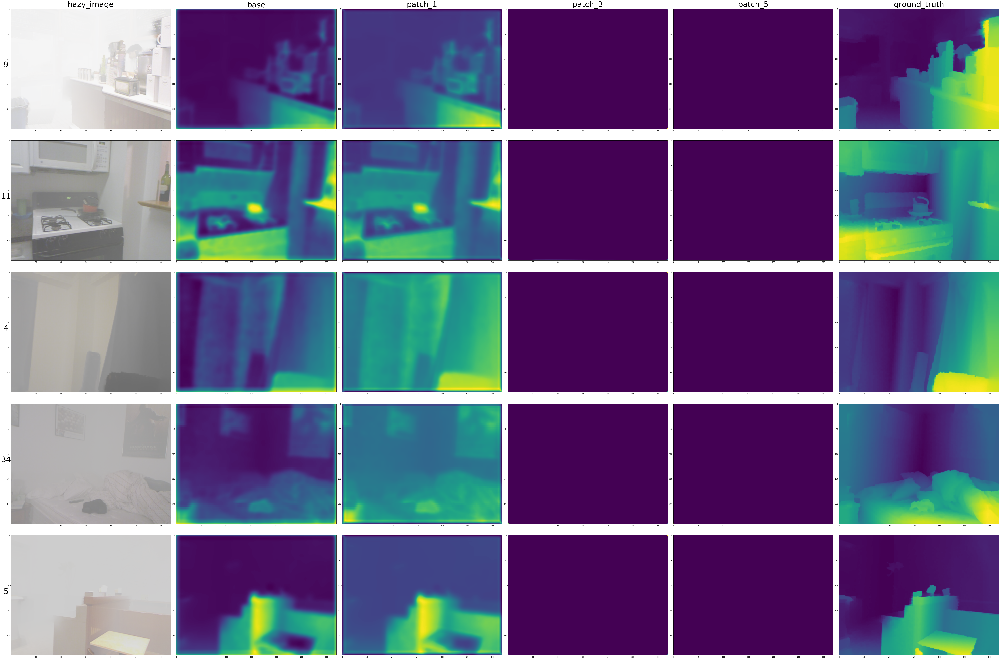

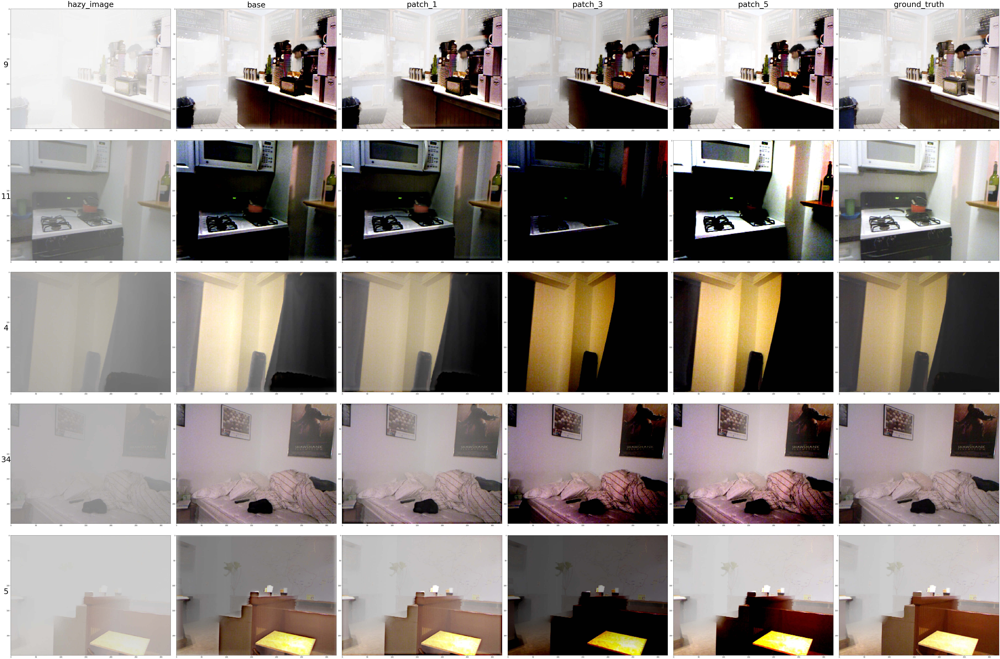

In [7]:
random_idcs=np.random.permutation(tst_file["hazy_image"].shape[0])[:5]
compare_models_on_images(models,tst_file,random_idcs,transmaps=True)
compare_models_on_images(models,tst_file,random_idcs,transmaps=False)

In [8]:
models.pop('ground_truth', None)
met=compute_metrics(models,tst_file)
display(met)

,model_name,psnr_orig,ssim_orig,psnr_best,ssim_best,psnr_tmap,ssim_tmap
0,base,8.734673,0.526044,14.100104,0.656557,20.901150,0.724311
1,patch_1,9.925823,0.604556,16.418651,0.746404,20.539201,0.710340
2,patch_3,5.585092,0.317889,9.846294,0.410807,13.845181,0.183240
3,patch_5,8.112637,0.495393,13.580756,0.630477,13.845181,0.183240


##### Observations

* It is clear from the plots that for patch_size=3 & 5, the model collapses to predict a single transmission value for the entire image. This is expected, as the minimizing function for such an auxiliary loss is a plane with all normals in the Z-direction. However, it's undesirable, which is why we also try a selective update rule.
* However patch_size of 1 performs really well, having a better PSNR and SSIM with respect to the original image and the best possible dehazed result (with the ground truth transmission map). However on comparing the transmission maps, the base model performs better - which is expected (at least for PSNR) as it is directly optimizing MSE (and PSNR is a function of MSE).

#### Gradient Similarity Update

In [9]:
model_paths={"base":"../saved_models/base/model_50",
             "patch_1":"../saved_models/p1_g1/model_50",
              "patch_3":"../saved_models/p3_g1/model_50",
                "patch_5":"../saved_models/p5_g1/model_50"
            }
models={}
for key in model_paths:
    mpath=model_paths[key]
    model = torch.load(mpath)
    models[key]=(model)
models["ground_truth"]=""

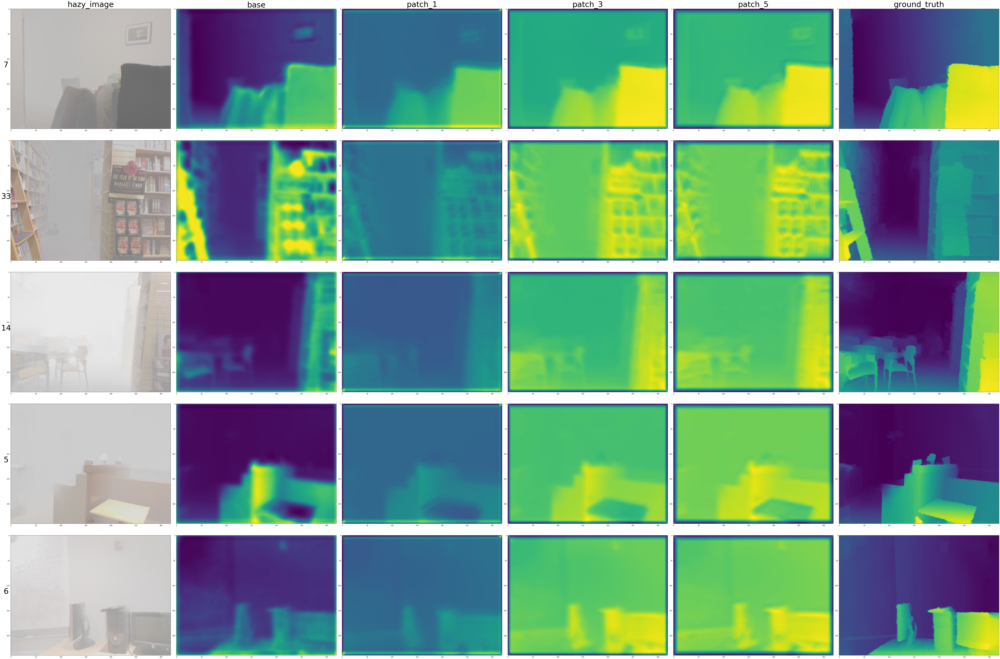

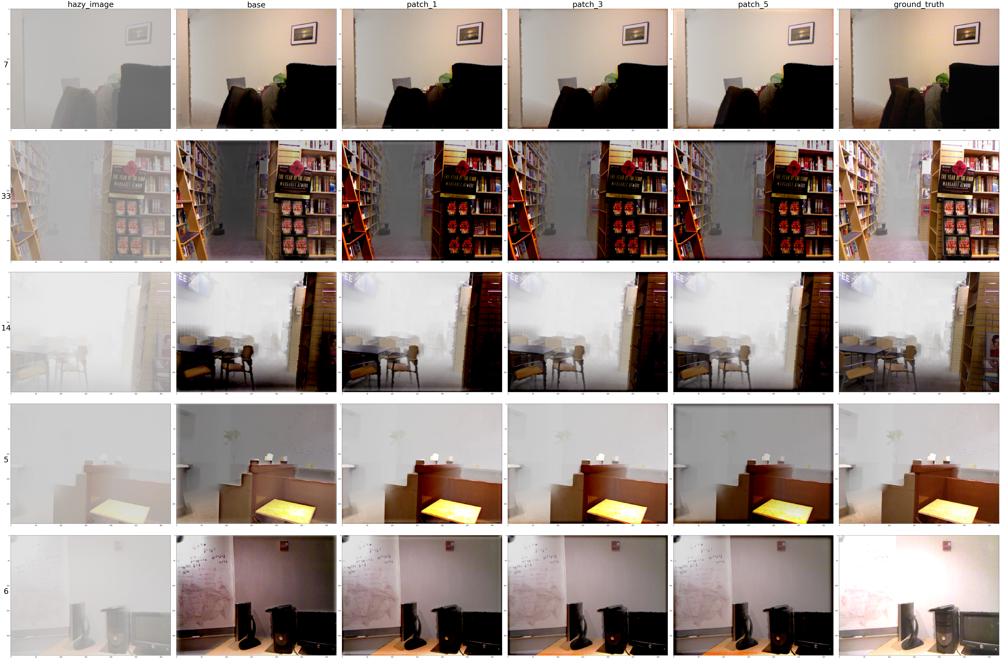

In [10]:
random_idcs=np.random.permutation(tst_file["hazy_image"].shape[0])[:5]
compare_models_on_images(models,tst_file,random_idcs,transmaps=True)
compare_models_on_images(models,tst_file,random_idcs,transmaps=False)

In [11]:
models.pop('ground_truth', None)
met=compute_metrics(models,tst_file)
display(met)

,model_name,psnr_orig,ssim_orig,psnr_best,ssim_best,psnr_tmap,ssim_tmap
0,base,8.734673,0.526044,14.100104,0.656557,20.901150,0.724311
1,patch_1,9.057753,0.550585,15.216916,0.671298,18.326258,0.673456
2,patch_3,9.442831,0.583998,15.223877,0.693528,17.708591,0.664750
3,patch_5,9.647122,0.595597,14.875046,0.699366,17.307720,0.655023


##### Observations

* With the selective update rule, none of the models collapse. What's interesting is that the trend of PSNR with respect to the original transmission is decreasing. But the PSNR,SSIM of the dehazed with respect to the original is increasing.
* Actually, any kind of trend is surprising, since we noticed thata large percentage of updates did not include the smoothness gradient.
* So overall the proposed method improves the dehazing results. However, the transmission map is inferior w.r.t. PSNR and SSIM metrics.

### Scaling Coefficient

``patch_size``= 3 for this experiment

#### Normal Update

In [12]:
model_paths={"base":"../saved_models/base/model_50",
             "scale_10":"../saved_models/s10_g0/model_50",
              "scale_100":"../saved_models/s100_g0/model_50",
                "scale_1000":"../saved_models/s1000_g0/model_50"
            }
models={}
for key in model_paths:
    mpath=model_paths[key]
    model = torch.load(mpath)
    models[key]=(model)
models["ground_truth"]=""

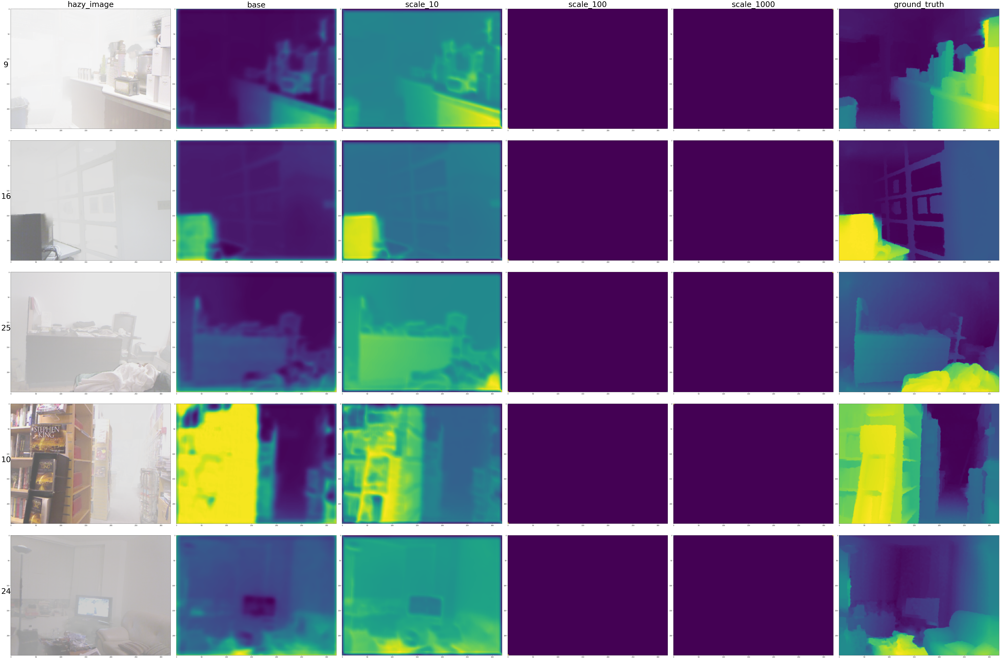

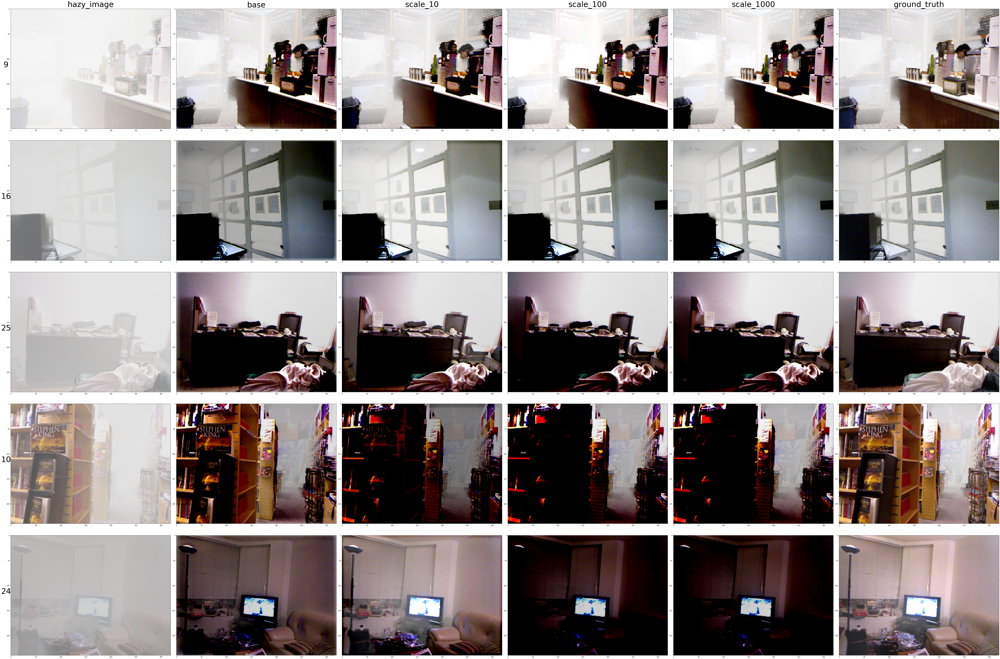

In [13]:
random_idcs=np.random.permutation(tst_file["hazy_image"].shape[0])[:5]
compare_models_on_images(models,tst_file,random_idcs,transmaps=True)
compare_models_on_images(models,tst_file,random_idcs,transmaps=False)

In [14]:
models.pop('ground_truth', None)
met=compute_metrics(models,tst_file)
display(met)

,model_name,psnr_orig,ssim_orig,psnr_best,ssim_best,psnr_tmap,ssim_tmap
0,base,8.734673,0.526044,14.100104,0.656557,20.901150,0.724311
1,scale_10,8.631072,0.528289,15.077537,0.658703,18.570605,0.680066
2,scale_100,6.018097,0.341020,10.852132,0.444228,13.845181,0.183240
3,scale_1000,6.712798,0.364493,10.926209,0.466360,13.845181,0.183240


##### Observations

* Clearly for large values of scaling coefficients, the model collapses due to the auxiliary loss dominating.
* Other than that, we should redo this experiment with patch_size=3, as that was the best result in the previous experiment. 

#### Gradient Similarity Update

In [15]:
model_paths={"base":"../saved_models/base/model_50",
             "scale_10":"../saved_models/s10_g1/model_50",
              "scale_100":"../saved_models/s100_g1/model_50",
                "scale_1000":"../saved_models/s1000_g1/model_50"
            }
models={}
for key in model_paths:
    mpath=model_paths[key]
    model = torch.load(mpath)
    models[key]=(model)
models["ground_truth"]=""

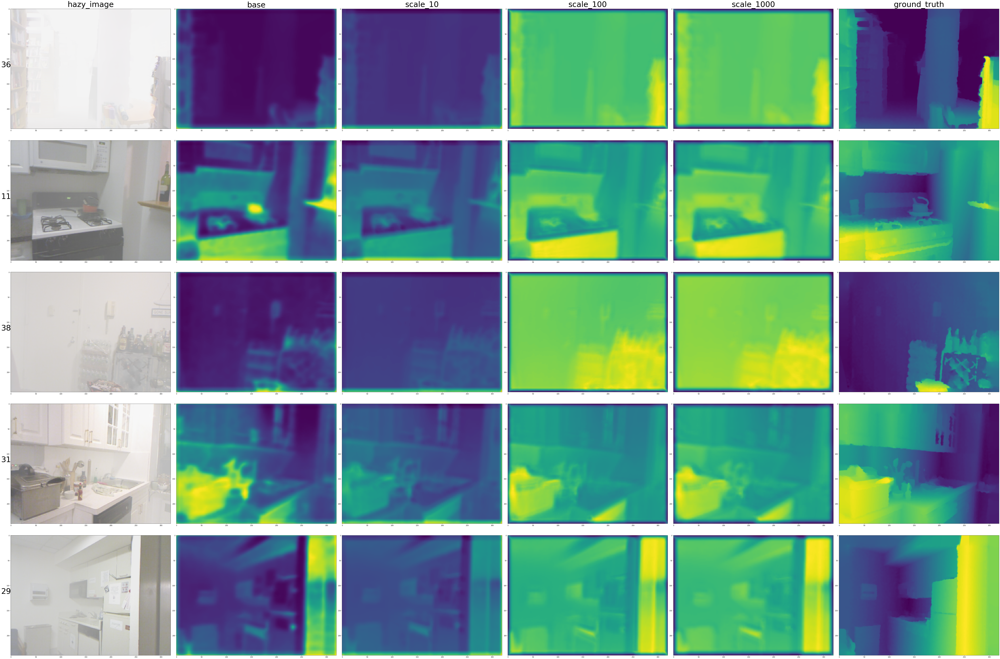

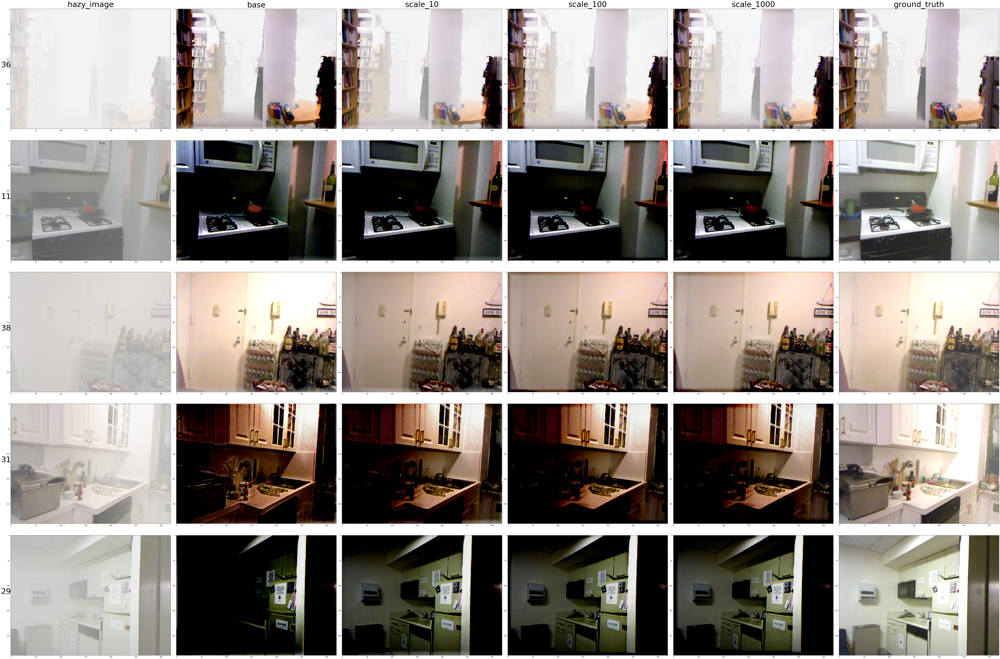

In [16]:
random_idcs=np.random.permutation(tst_file["hazy_image"].shape[0])[:5]
compare_models_on_images(models,tst_file,random_idcs,transmaps=True)
compare_models_on_images(models,tst_file,random_idcs,transmaps=False)

In [17]:
models.pop('ground_truth', None)
met=compute_metrics(models,tst_file)
display(met)

,model_name,psnr_orig,ssim_orig,psnr_best,ssim_best,psnr_tmap,ssim_tmap
0,base,8.734673,0.526044,14.100104,0.656557,20.901150,0.724311
1,scale_10,9.704428,0.583711,15.664434,0.697914,18.056884,0.673297
2,scale_100,9.148298,0.567842,14.862136,0.683551,17.848752,0.665046
3,scale_1000,9.266314,0.577071,14.807105,0.690229,17.561510,0.658690


##### Observations

* With gradient based update, it appears that even ``patch_size=3`` works well for even large scaling coefficients. 
* There is some trend of better dehazing with worse tmaps with increasing effect of smoothness loss here.